In [1]:
# 数据转换
housing=house_train.drop('median_house_value',axis=1)
labels=house_train['median_house_value'].copy()

NameError: name 'house_train' is not defined

In [2]:
import pandas as pd
import os
HOUSING_PATH = "datasets/housing"
def load_housing_data(housing_path=HOUSING_PATH):
    csv_path = os.path.join(housing_path, "housing.csv")
    return pd.read_csv(csv_path)
house=load_housing_data()
house.describe()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


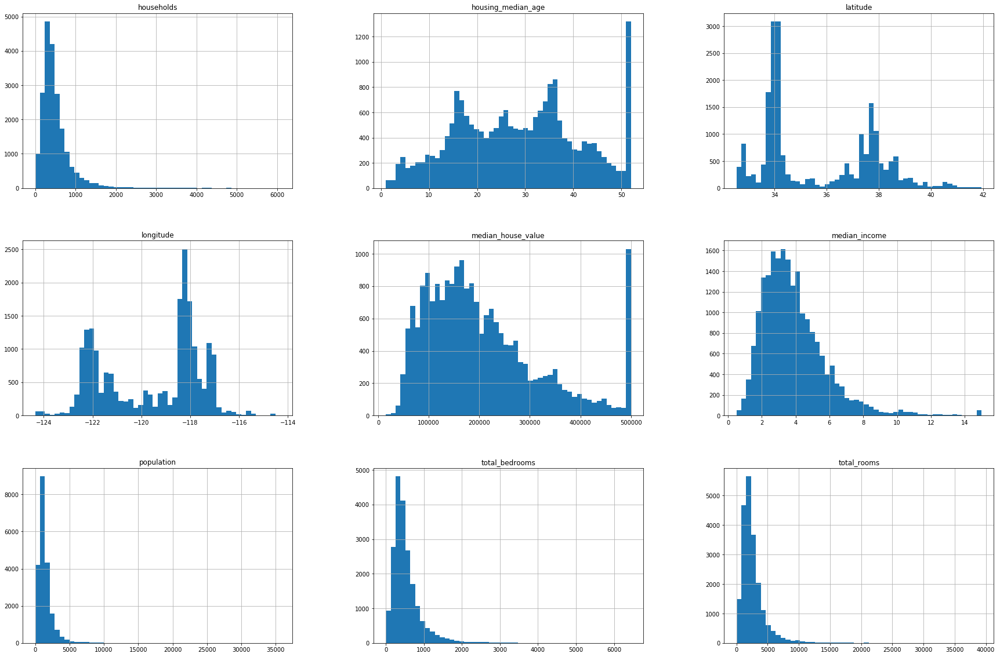

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
house.hist(bins=50,figsize=(30,20))
plt.show()


In [4]:
# 随机抽取测试集
import numpy as np
def split_train_test(data,radio):
        random=np.random.permutation(data)
        testsize=int(len(data)*radio)
        test=data[:testsize]
        train=data[testsize:]
        return train,test
train,test=split_train_test(house,0.2)
train.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,16512.000000,16512.000000,16512.000000,16512.000000,16342.000000,16512.000000,16512.000000,16512.000000,16512.000000
mean,-119.315755,35.317798,28.522771,2668.759811,547.175621,1458.764898,507.944344,3.932357,216493.028949
std,1.953438,2.078606,12.547098,2241.972781,431.845621,1170.414398,389.581217,1.914082,116168.567688
min,-123.850000,32.540000,1.000000,6.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.370000,33.870000,18.000000,1460.750000,300.000000,803.000000,284.000000,2.622475,131300.000000
50%,-118.310000,34.100000,29.000000,2151.000000,442.500000,1195.500000,417.000000,3.593800,186800.000000
75%,-117.910000,37.422500,37.000000,3180.250000,658.000000,1764.000000,614.000000,4.796200,275000.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [5]:
# 根据hash的最后一个字节大小抽取
import hashlib

def test_check(id,radio):
        return hashlib.md5(np.int64(id)).digest()[-1]<256*radio
def train_test_split(data,id,radio):
        ids=data[id]
        test=ids.apply(lambda id_:test_check(id_,radio))
        return data.loc[~test],data.loc[test]
house_with_id=house.reset_index()
train,test=train_test_split(house_with_id,"index",0.2)
len(test)

4278

In [6]:
house_with_id['id']=house_with_id['longitude']*1000+house_with_id['latitude']
train,test=train_test_split(house_with_id,"id",0.2)


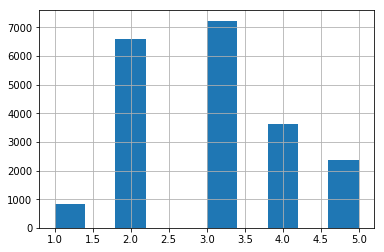

In [7]:
# 分层抽取
house_with_id['income_cat']=np.ceil(house_with_id['median_income']/1.5)
house_with_id['income_cat'].where(house_with_id['income_cat']<5,5.0,inplace=True)
house_with_id.head()
house_with_id['income_cat'].hist()

In [8]:
from sklearn.model_selection import StratifiedShuffleSplit
split=StratifiedShuffleSplit(n_splits=1,test_size=0.2,random_state=42)
for train,test in split.split(house_with_id,house_with_id['income_cat']):
        train_set=house_with_id.loc[train]
        test_set=house_with_id.loc[test]
train_set['income_cat'].value_counts()/len(train_set)
for set in (train_set,test_set):
        set.drop("income_cat",axis=1,inplace=True)

In [9]:
house_train=train_set.copy()

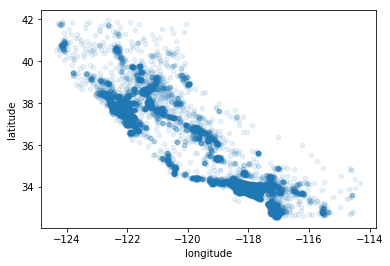

In [10]:
# 地理分布图
%matplotlib inline
house_train.plot(kind="scatter",x='longitude',y='latitude',alpha=0.1)


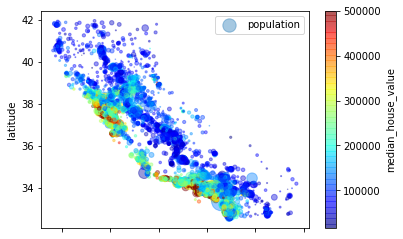

In [11]:
# 人口、房价分布
house_train.plot(kind="scatter",x='longitude',y='latitude',alpha=0.4,s=house_train['population']/100,
label="population",c="median_house_value",cmap=plt.get_cmap("jet"),colorbar=True)
plt.legend()

In [12]:
# train_test_split

In [13]:
# 相关系数
corr_matrix=house_train.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)


median_house_value    1.000000
median_income         0.687160
total_rooms           0.135097
housing_median_age    0.114110
index                 0.067723
households            0.064506
total_bedrooms        0.047689
population           -0.026920
longitude            -0.047432
id                   -0.047632
latitude             -0.142724
Name: median_house_value, dtype: float64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000016E20003EF0>,
      dtype=object)

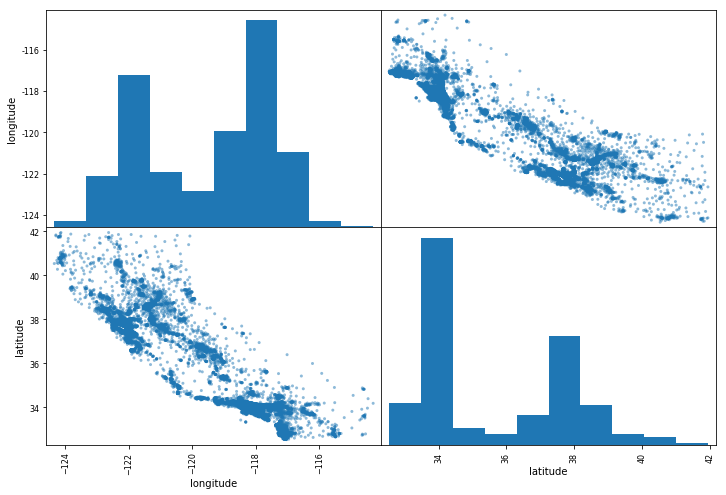

In [14]:
from pandas.plotting import scatter_matrix
cols=['longitude','latitude']
scatter_matrix(house[cols],figsize=(12,8))


In [15]:
# 属性组合
house_train["rooms_per_household"] = house_train["total_rooms"]/house_train["households"]
house_train["bedrooms_per_room"] = house_train["total_bedrooms"]/house_train["total_rooms"]
house_train["population_per_household"]=house_train["population"]/house_train["households"]

corr_matrix=house_train.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)


median_house_value          1.000000
median_income               0.687160
rooms_per_household         0.146285
total_rooms                 0.135097
housing_median_age          0.114110
index                       0.067723
households                  0.064506
total_bedrooms              0.047689
population_per_household   -0.021985
population                 -0.026920
longitude                  -0.047432
id                         -0.047632
latitude                   -0.142724
bedrooms_per_room          -0.259984
Name: median_house_value, dtype: float64

In [16]:
# 数据转换
housing=house_train.drop('median_house_value',axis=1)
labels=house_train['median_house_value'].copy()
